# MTH3302 : Méthodes probabilistes et statistiques pour l'I.A.

Jonathan Jalbert<br/>
Professeur agrégé au Département de mathématiques et de génie industriel<br/>
Polytechnique Montréal<br/>

# Projet A2021 : Prédire les maladies cardiaques

La description du projet est disponible à l'adresse suivante :
https://www.kaggle.com/t/3a185493d8bb48d8961ad50e465bed4f

Ce calepin Jupyter de base permet de 

1. Charger les données fournies.
2. Effectuer une analyse exploratoire sommaire des données.
3. Développer un modèle simple de prédiction.
4. Générer le fichier de prédictions à téléverser sur Kaggle.

Dans un premier temps, vous devrez récupérer les données sous l'onglet *data* du site Kaggle. Il y a deux fichiers :
- train.csv
- test.csv

Le fichier *train.csv* contient les données sur lesquelles vous pouvez entraîner votre modèle. Il sera ensuite évaluée sur les données de l'ensemble *test.csv* lorsque vous aurez téléversé vos prédictions sur Kaggle. 

### Consignes

- Vous devez constituer une équipe de 3 à 5 personnes.
- Au moins une solution doit être proposée sur Kaggle.
- Utilisez votre numéro d'équipe pour téléverser vos prédictions sur Kaggle.
- Un seul fichier .ipynb par équipe faisant office de rapport et permettant de reproduire vos meilleures prédictions doit être remis.
- Le langage Julia doit être utilisé.
- Votre démarche doit être rigoureusement justifiée (consultez la grille de correction pour vous orienter).

### Quelques conseils

Votre calepin doit permettre de suivre clairement votre raisonnement et de reproduire vos résultats. Garder à l'esprit que vos résultats et votre démarche doivent être reproductibles par une personne à l'extérieur de votre équipe. Le calepin constitue le rapport. Servez vous des cellules de texte pour décrire ce que vous faites.

Je vous encourage fortement à faire une analyse exploratoire de vous données pour développer une meilleure expertise du problème. C'est une étape qui est toujours négligée par les débutants mais qui est essentielle. C'est avec l'analyse exploratoire que vous viendra des idées d'amélioration, par exemple créer de nouvelles variables explicatives.

Vous pouvez utiliser directement tout ce qui se retrouve dans les notes de cours sans explication et toutes les librairies utilisées dans le cours (incluant mes fonctions).

Ce calepin de base contient un modèle très simple de prédiction : on prédit 0 débordement à tous les jours. Ce sera votre travail d'améliorer ces prédictions naïves avec la méthode de votre choix.

Il faudra que vous trouviez un moyen de traiter les données manquantes. La plupart du temps, une méthode simple d'imputation (de remplacement) des données manquantes est appropriée.

Prenez la peine de tout documenter, même les essais infructueux. Ce n'est pas nécessaire de les expliquer en détails, mais c'est important de les mentionner au moins succintement dans la discussion avec une raison possible pour leur échec. De cette façon, une personne qui reprendra votre travail dans le futur ne perdra pas de temps à réessayer une méthode déjà implémentée et infructueuse.

Vous pouvez aussi indiquer dans votre rapport les raisons qui vous font croire pourquoi une méthode à moins bien performée que ce à quoi vous vous attendiez. Vous pouvez également mentionner ce que vous auriez pu tenter si vous aviez eu plus de temps ou plus de données, etc. L'idée est de guider le prochain scientifique qui prendra la relève de votre travail.

Vous êtes limités à deux soumissions par jour par équipe sur Kaggle. Je vous suggère donc de bien tester vos modèles localement et de ne téléverser que vos meilleurs candidats.

In [1]:
ENV["COLUMNS"] = 150
using CSV, DataFrames, Gadfly, GLM, Statistics, LinearAlgebra, Distributions, Combinatorics, StatsBase, MLBase, Random
include("functions.jl");

### 1. Chargement des données

In [132]:
data = CSV.read("train.csv", DataFrame)
first(data,5)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String,String,Int64,Int64?,Int64,String,Int64,String,Float64,String,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1


## 2. Analyse exploratoire

#### En premier lieu, nous allons visualiser le l'échantillon d'entrainement que nous avons à l'aide des graphiques.

Avant d'afficher des graphiques, nous avons jetté un coup d'oeil sur les données du projet.
Voici les variables explicatives de nos données et leurs valeurs possibles:


#### Variables explicatives:
- **Age** Valeurs: Ensemble des entiers positives

- **Sex** Valeurs qualitatives possibles: *M, F*

- **ChestPainType** Valeurs qualitatives possibles: *ASY, NAP, ATA, TA*

- **RestingBP** Valeurs: Ensemble des entiers positives

- **Cholesterol** Valeurs: Ensemble des entiers positives

- **FastingBS** Valeurs: Ensemble des entiers positives

- **RestingECG** Valeurs qualitatives possibles: *Normal, LVH, ST*

- **MaxHR** Valeurs: Ensemble des entiers positives

- **ExerciseAngina** Valeurs qualitatives possibles: *Y, N*

- **Oldpeak** Valeurs: Ensemble réelles

- **STSlope** Valeurs qualitatives possibles: *Flat, Up, Down*


La variable à estimer est **HeartDisease** qui prend les valeurs *0, 1*.

#### 2.1 HeartDisease en fonction des variables explicatives.

In [133]:
plots = Plot[]
properties = propertynames(data[!, Not([:ID, :HeartDisease])])
for property in properties
    push!(
        plots,
        plot(
            data, 
            x=property, 
            y=:HeartDisease,
            color=[colorant"gold"],
            Guide.title("HeartDisease en fonction de $property")
            )
    )
end
vstack(plots)

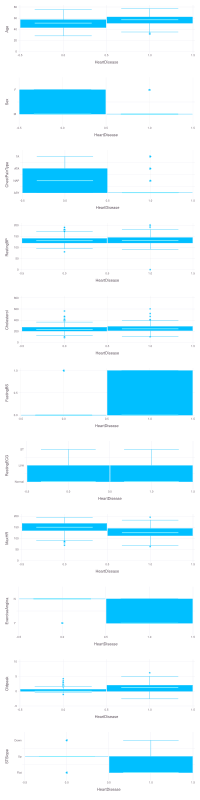

In [134]:
plots = Plot[]

for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    if propertyname == :Cholesterol
        push!(
            plots,
            plot(
                dropmissing(
                    DataFrame(
                        Cholesterol=data.Cholesterol,
                        HeartDisease=data.HeartDisease
                    )),
                x="HeartDisease",
                y="Cholesterol",
                Geom.boxplot,
            )
        )
    else
        push!(
            plots,
            plot(
                data,
                x=:HeartDisease,
                y=propertyname,
                Geom.boxplot,
            )
        )
    end
end


vstack(plots)

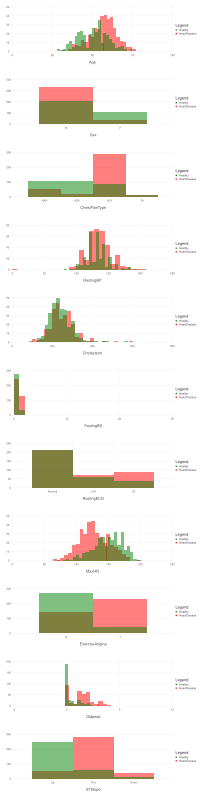

In [135]:
plots = Plot[]
for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    push!(
        plots,
        plot(
            [layer(
                filter(row -> row.HeartDisease == i, data),
                x=propertyname,
                Geom.histogram(bincount=floor(sqrt(nrow(data)))),
                Theme(default_color=i == 0 ? "green" : "red", alphas=[0.5]),
            ) for i = 0:1]...,
            Guide.xlabel(string(propertyname)),
            Guide.manual_color_key("Legend", ["Healthy", "HeartDisease"], ["green", "red"]),
        )
    )
end
vstack(plots)

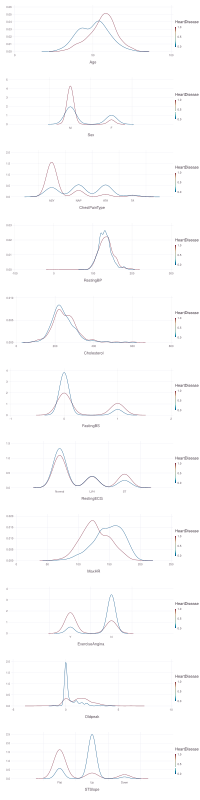

In [136]:
plots = Plot[]

for propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    if propertyname == :Cholesterol
        push!(
            plots,
            plot(
                dropmissing(
                    DataFrame(
                        Cholesterol=data.Cholesterol,
                        HeartDisease=data.HeartDisease
                    )),
                x=:Cholesterol,
                color=:HeartDisease,
                Geom.density,
                Guide.xlabel("Cholesterol"),
                Guide.colorkey(title="HeartDisease"),
            )
        )
    else
    push!(
        plots,
        plot(
            data,
            x=propertyname,
            color=:HeartDisease,
            Geom.density,
            Guide.xlabel(string(propertyname)),
            Guide.colorkey(title="HeartDisease"),
        )
    )
    end
end



vstack(plots)

### 3 Préparation des données

In [137]:
Random.seed!(1998)

ntrain = round(Int, 0.80 * nrow(data))

train_id = sample(1:nrow(data), ntrain, replace=false, ordered=true)
valid_id = setdiff(1:nrow(data), train_id)

train = data[train_id, :]
valid = data[valid_id, :]

first(train, 5)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String,String,Int64,Int64?,Int64,String,Int64,String,Float64,String,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1


In [138]:
function replaceMissingCholesterolMean(dataframe::DataFrame)
    cholesterol_mean = floor(Int, mean(skipmissing(dataframe.Cholesterol)))
    dataframe[!, :Cholesterol] = coalesce.(dataframe.Cholesterol, cholesterol_mean);
    println("Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: $cholesterol_mean")
end

function removeMissingCholesterolRows(dataframe::DataFrame)
    dropmissing!(dataframe)
    println("Toutes les lignes avec une valeur manquante sont retirés")
end

replaceMissingCholesterolMean(train)

first(train, 5)

Toutes les valeurs manquantes ont été remplancées par la moyenne de la colonne Cholesterol: 245


,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String,String,Int64,Int64,Int64,String,Int64,String,Float64,String,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,245,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,245,0,Normal,80,Y,0.0,Flat,1


In [139]:
function transformQualitativeVariables(dataframe::DataFrame)
    n = nrow(dataframe)
    sex = zeros(Int, n)
    for i in 1:n
        if (dataframe.Sex[i] == "M")
            sex[i] = 1;
        end
    end
    dataframe[!, :Sex] = sex;

    ChestPainType1 = zeros(Int, n)
    ChestPainType2 = zeros(Int, n)
    ChestPainType3 = zeros(Int, n)
    for i in 1:n
        if (dataframe.ChestPainType[i] == "ATA")
            ChestPainType1[i] = 1;
        elseif (dataframe.ChestPainType[i] == "NAP")
            ChestPainType2[i] = 1; 
        elseif (dataframe.ChestPainType[i] == "ASY")
            ChestPainType3[i] = 1;
        end
    end
    select!(dataframe, Not(:ChestPainType))
    dataframe[!, :ChestPainType1] = ChestPainType1;
    dataframe[!, :ChestPainType2] = ChestPainType2;
    dataframe[!, :ChestPainType3] = ChestPainType3;

    # RestingBP
    restingECG1 = zeros(Int, n)
    restingECG2 = zeros(Int, n)

    for i in 1:n
        if (dataframe.RestingECG[i] == "ST")
            restingECG1[i] = 1;
        elseif (dataframe.RestingECG[i] == "LVH")
            restingECG2[i] = 1;  
        end
    end
    select!(dataframe, Not(:RestingECG))
    dataframe[!, :RestingECG1] = restingECG1;
    dataframe[!, :RestingECG2] = restingECG2;


    exerciseAngina = zeros(Int, n)
    for i in 1:n
        if (dataframe.ExerciseAngina[i] == "Y")
            exerciseAngina[i] = 1;
        end
    end
    dataframe[!, :ExerciseAngina] = exerciseAngina;


    STSlope1 = zeros(Int, n)
    STSlope2 = zeros(Int, n)

    for i in 1:n
        if (dataframe.STSlope[i] == "Flat")
            STSlope1[i] = 1;
        elseif (dataframe.STSlope[i] == "Down")
            STSlope2[i] = 1;  
        end
    end
    select!(dataframe, Not(:STSlope))
    dataframe[!, :STSlope1] = STSlope1;
    dataframe[!, :STSlope2] = STSlope2;

end


transformQualitativeVariables (generic function with 1 method)

In [140]:
transformQualitativeVariables(train)
propertynames(select(train, Not([:ID, :HeartDisease])))

15-element Array{Symbol,1}:
 :Age
 :Sex
 :RestingBP
 :Cholesterol
 :FastingBS
 :MaxHR
 :ExerciseAngina
 :Oldpeak
 :ChestPainType1
 :ChestPainType2
 :ChestPainType3
 :RestingECG1
 :RestingECG2
 :STSlope1
 :STSlope2

### 4 Fonctions d'entraînement de modèles

In [141]:
HEART_DESEASE_POSITIVE = filter(row -> row.HeartDisease != 0, data)
HEART_DESEASE_NEGATIVE = filter(row -> row.HeartDisease == 0, data)

n₁ = size(HEART_DESEASE_POSITIVE, 1)
n₀ = size(HEART_DESEASE_NEGATIVE, 1)
n = n₁ + n₀

#Les probabilités marginales
(α,β) = (1,1)
p₁ = (α + n₁)/(α + β + n)
p₀ = (β + n₀)/(α + β + n)

0.4579710144927536

In [232]:
function viewVariableDistribution(dataframe::DataFrame, property::Symbol)
    graphs_distributions = Dict(
        :Age => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
        :Sex => [Normal{Float64}, Bernoulli{Float64}],
        :RestingBP => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}],
        :Cholesterol => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
        :FastingBS => [Normal{Float64}, Bernoulli{Float64}],
        :MaxHR => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}, LogNormal{Float64}, Gamma{Float64}],
        :ExerciseAngina => [Normal{Float64}, Bernoulli{Float64}],
        :Oldpeak => [Normal{Float64}, InverseGaussian{Float64}, Cauchy{Float64}],
        :ChestPainType1 => [Normal{Float64}, Bernoulli{Float64}],
        :ChestPainType2 => [Normal{Float64}, Bernoulli{Float64}],
        :ChestPainType3 => [Normal{Float64}, Bernoulli{Float64}],
        :RestingECG1 => [Normal{Float64}, Bernoulli{Float64}],
        :RestingECG2 => [Normal{Float64}, Bernoulli{Float64}],
        :STSlope1 => [Normal{Float64}, Bernoulli{Float64}],
        :STSlope2 => [Normal{Float64}, Bernoulli{Float64}],
    )

    distributions = graphs_distributions[property]

    plots = Plot[]
    colors = Scale.color_discrete_hue().f(length(distributions))

    for i = 0:1
        title = "No Disease"
        if i == 0
            title = "Heart Disease"
        end
        xip = dataframe[dataframe.HeartDisease .== i, property]

        layers = []
        for j=1:length(distributions)
            push!(
                layers,
                layer(x -> pdf(fit(distributions[j], xip), x),
                minimum(xip), maximum(xip),
                Theme(default_color=colors[j])
            ))
        end


        push!(
            plots,
            plot(
                layers...,
                layer(
                    x=xip,
                    alpha=repeat([1, 0.85],
                    outer=floor(Int, sqrt(length(xip)))),
                    Geom.histogram(bincount=floor(Int, sqrt(length(xip))), density=true)),
                    Guide.title(title),
                    Guide.xlabel(string(property)
                ),
            )
        )

    end

    property_count = ncol(dataframe[!, setdiff(propertynames(dataframe), [:ID, :HeartDisease])])
    grid_plot = gridstack(reshape(plots, (1, 2)))

    legend_plot = plot(Guide.manual_color_key("Légende", string.(distributions), colors))

    Gadfly.set_default_plot_size(20cm, 8cm)
    display(grid_plot)
    Gadfly.set_default_plot_size(5cm, 4cm)
    display(legend_plot)
end


viewVariableDistribution (generic function with 3 methods)

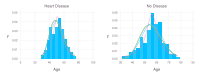

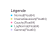

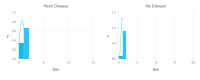

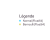

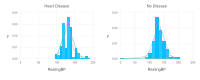

...

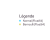

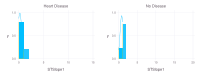

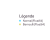

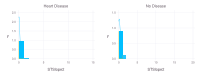

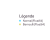

In [233]:
function printDistributionGraphs()
    for property in propertynames(select(train, Not([:ID, :HeartDisease])))
        viewVariableDistribution(train, property)
    end
end
printDistributionGraphs()

### 5 Fonctions de prédiction pour les modèles

### 6 Choix et entraînement du modèle

### 7. Prédiction des tumeurs malignes de l'ensemble de test

In [234]:
typeof(:Age)

Symbol